# [Pytorch-YOLO5S]Blood_Cell_Detection w/ BCCD

Here you can find my work to train and detect cells with Yolov5 with BCCD_Dataset.

In this notebook;

In this notebook,I implemented a YOLO on BCCD dataset consisting of cell images and I trained the YOLO for object detection / classification purposes.

Below steps were applied through model build-up :

- Select smaller scale Pytorch YOLOV5 algorithm to implement training and detection to use computational resources efficiently.
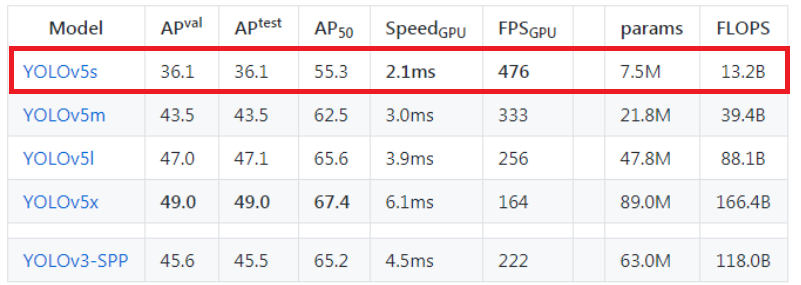

- Download the BCCD Data Set.
- Parse XML annotations to Pandas Dataframe to manipulate the data.
- To train the Yolov5 model, .txt files are produced with bounding box features and encoded label which is compatible with Yolov5 by using preprocessing techniques including normalization and Sklearn LabelEncoder tool.
- Train the model and observe the results in Tensorboard.
- Model Performance Scores: Precision: 0.0899 | Recall 0.827 | 
mean average precision 0.0879 |
- Output txt labels are reflected to images to verify whether model output can be visualized.



In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [27]:
%cd "/content/drive/My Drive"

/content/drive/My Drive


In [ ]:
!git clone 'https://github.com/Shenggan/BCCD_Dataset.git'

In [41]:
import os, sys, random, shutil
import xml.etree.ElementTree as ET
from glob import glob
import pandas as pd
from shutil import copyfile
import pandas as pd
from sklearn import preprocessing, model_selection
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib import patches
import numpy as np

In [ ]:
annotations = sorted(glob('/content/drive/My Drive/BCCD_Dataset/BCCD/Annotations/*.xml'))

# Data Preprocessing and Manipulation

In [ ]:
df = []
cnt = 0
for file in annotations:
  prev_filename = file.split('/')[-1].split('.')[0] + '.jpg'
  filename = str(cnt) + '.jpg'
  row = []
  parsedXML = ET.parse(file)
  for node in parsedXML.getroot().iter('object'):
    blood_cells = node.find('name').text
    xmin = int(node.find('bndbox/xmin').text)
    xmax = int(node.find('bndbox/xmax').text)
    ymin = int(node.find('bndbox/ymin').text)
    ymax = int(node.find('bndbox/ymax').text)

    row = [prev_filename, filename, blood_cells, xmin, xmax, ymin, ymax]
    df.append(row)
  cnt += 1

data = pd.DataFrame(df, columns=['prev_filename', 'filename', 'cell_type', 'xmin', 'xmax', 'ymin', 'ymax'])

data[['prev_filename','filename', 'cell_type', 'xmin', 'xmax', 'ymin', 'ymax']].to_csv('/content/drive/My Drive/blood_cell_detection.csv', index=False)
data.head(10)


,prev_filename,filename,cell_type,xmin,xmax,ymin,ymax
0,BloodImage_00000.jpg,0.jpg,WBC,260,491,177,376
1,BloodImage_00000.jpg,0.jpg,RBC,78,184,336,435
2,BloodImage_00000.jpg,0.jpg,RBC,63,169,237,336
3,BloodImage_00000.jpg,0.jpg,RBC,214,320,362,461
4,BloodImage_00000.jpg,0.jpg,RBC,414,506,352,445
5,BloodImage_00000.jpg,0.jpg,RBC,555,640,356,455
6,BloodImage_00000.jpg,0.jpg,RBC,469,567,412,480
7,BloodImage_00000.jpg,0.jpg,RBC,1,87,333,437
8,BloodImage_00000.jpg,0.jpg,RBC,4,95,406,480
9,BloodImage_00000.jpg,0.jpg,RBC,155,247,74,174


Normalization is applied to annotations. Below code will convert the annotations in (1,1) plane.

In [ ]:
img_width = 640
img_height = 480

def width(df):
  return int(df.xmax - df.xmin)
def height(df):
  return int(df.ymax - df.ymin)
def x_center(df):
  return int(df.xmin + (df.width/2))
def y_center(df):
  return int(df.ymin + (df.height/2))
def w_norm(df):
  return df/img_width
def h_norm(df):
  return df/img_height

df = pd.read_csv('/content/drive/My Drive/blood_cell_detection.csv')

le = preprocessing.LabelEncoder()
le.fit(df['cell_type'])
print(le.classes_)
labels = le.transform(df['cell_type'])
df['labels'] = labels

df['width'] = df.apply(width, axis=1)
df['height'] = df.apply(height, axis=1)

df['x_center'] = df.apply(x_center, axis=1)
df['y_center'] = df.apply(y_center, axis=1)

df['x_center_norm'] = df['x_center'].apply(w_norm)
df['width_norm'] = df['width'].apply(w_norm)

df['y_center_norm'] = df['y_center'].apply(h_norm)
df['height_norm'] = df['height'].apply(h_norm)

df.head(30)

['Platelets' 'RBC' 'WBC']


,prev_filename,filename,cell_type,xmin,xmax,ymin,ymax,labels,width,height,x_center,y_center,x_center_norm,width_norm,y_center_norm,height_norm
0,BloodImage_00000.jpg,0.jpg,WBC,260,491,177,376,2,231,199,375,276,0.585938,0.360938,0.575000,0.414583
1,BloodImage_00000.jpg,0.jpg,RBC,78,184,336,435,1,106,99,131,385,0.204687,0.165625,0.802083,0.206250
2,BloodImage_00000.jpg,0.jpg,RBC,63,169,237,336,1,106,99,116,286,0.181250,0.165625,0.595833,0.206250
3,BloodImage_00000.jpg,0.jpg,RBC,214,320,362,461,1,106,99,267,411,0.417187,0.165625,0.856250,0.206250
4,BloodImage_00000.jpg,0.jpg,RBC,414,506,352,445,1,92,93,460,398,0.718750,0.143750,0.829167,0.193750
5,BloodImage_00000.jpg,0.jpg,RBC,555,640,356,455,1,85,99,597,405,0.932813,0.132812,0.843750,0.206250
6,BloodImage_00000.jpg,0.jpg,RBC,469,567,412,480,1,98,68,518,446,0.809375,0.153125,0.929167,0.141667
7,BloodImage_00000.jpg,0.jpg,RBC,1,87,333,437,1,86,104,44,385,0.068750,0.134375,0.802083,0.216667
8,BloodImage_00000.jpg,0.jpg,RBC,4,95,406,480,1,91,74,49,443,0.076563,0.142187,0.922917,0.154167
9,BloodImage_00000.jpg,0.jpg,RBC,155,247,74,174,1,92,100,201,124,0.314063,0.143750,0.258333,0.208333


All dataframe rows are iterated and saved to .txt files as labels of bounding boxes.

In [ ]:
df_train, df_valid = model_selection.train_test_split(df, test_size=0.1, random_state=13, shuffle=True)
print(df_train.shape, df_valid.shape)

os.mkdir('/content/drive/My Drive/bcc/')
os.mkdir('/content/drive/My Drive/bcc/images/')
os.mkdir('/content/drive/My Drive/bcc/images/train/')
os.mkdir('/content/drive/My Drive/bcc/images/valid/')

os.mkdir('/content/drive/My Drive/bcc/labels/')
os.mkdir('/content/drive/My Drive/bcc/labels/train/')
os.mkdir('/content/drive/My Drive/bcc/labels/valid/')

def segregate_data(df, img_path, label_path, train_img_path, train_label_path):
  filenames = []
  for filename in df.filename:
    filenames.append(filename)
  filenames = set(filenames)
  
  for filename in filenames:
    yolo_list = []

    for _,row in df[df.filename == filename].iterrows():
      yolo_list.append([row.labels, row.x_center_norm, row.y_center_norm, row.width_norm, row.height_norm])

    yolo_list = np.array(yolo_list)
    txt_filename = os.path.join(train_label_path,str(row.prev_filename.split('.')[0])+".txt")
    # Save the .img & .txt files to the corresponding train and validation folders
    np.savetxt(txt_filename, yolo_list, fmt=["%d", "%f", "%f", "%f", "%f"])
    shutil.copyfile(os.path.join(img_path,row.prev_filename), os.path.join(train_img_path,row.prev_filename))
 
## Apply function ## 
src_img_path = "/content/drive/My Drive/BCCD_Dataset/BCCD/JPEGImages/"
src_label_path = "/content/drive/My Drive/BCCD_Dataset/BCCD/Annotations/"

train_img_path = "/content/drive/My Drive/bcc/images/train"
train_label_path = "/content/drive/My Drive/bcc/labels/train"

valid_img_path = "/content/drive/My Drive/bcc/images/valid"
valid_label_path = "/content/drive/My Drive/bcc/labels/valid"

segregate_data(df_train, src_img_path, src_label_path, train_img_path, train_label_path)
segregate_data(df_valid, src_img_path, src_label_path, valid_img_path, valid_label_path)

print("No. of Training images", len(os.listdir('/content/drive/My Drive/bcc/images/train')))
print("No. of Training labels", len(os.listdir('/content/drive/My Drive/bcc/labels/train')))

print("No. of valid images", len(os.listdir('/content/drive/My Drive/bcc/images/valid')))
print("No. of valid labels", len(os.listdir('/content/drive/My Drive/bcc/labels/valid')))

(4399, 16) (489, 16)
No. of Training images 364
No. of Training labels 364
No. of valid images 270
No. of valid labels 270


In [ ]:
!git clone 'https://github.com/ultralytics/yolov5.git'

Cloning into 'yolov5'...
remote: Enumerating objects: 12190, done.
remote: Counting objects: 100% (66/66), done.
remote: Compressing objects: 100% (60/60), done.
remote: Total 12190 (delta 31), reused 26 (delta 6), pack-reused 12124
Receiving objects: 100% (12190/12190), 12.63 MiB | 9.79 MiB/s, done.
Resolving deltas: 100% (8376/8376), done.


bcc.yaml file is constructed and saved into the directory then this file is copied as bcc.yaml file inside /yolov5 directory. Inside bcc.yaml the configuration is as follows for class numbers an items. After training starts then cfg file will be overwrited with that yaml file.

#bcc.yaml
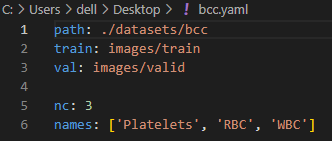

In [ ]:
!pip install -qr '/content/drive/My Drive/yolov5/requirements.txt'  # install dependencies

Dependencies for algorithm are installed

In [ ]:
shutil.copyfile("bcc.yaml", '/content/drive/My Drive/yolov5/bcc.yaml')

'/content/drive/My Drive/yolov5/bcc.yaml'

# Training :
We need to configure the training parameters such as no.of epochs, batch_size, etc.,

Training Parameters
!python
- <'location of train.py file'>
- --img <'width of image'>
- --batch <'batch size'>
- --epochs <'no of epochs'>
- --data <'location of the .yaml file'>
- --cfg <'Which yolo configuration you want'>(yolov5s/yolov5m/yolov5l/yolov5x).yaml | (small, medium, large, xlarge)
- --name <'Name of the best model to save after training'>

In [ ]:
!python yolov5/train.py --img 640 --batch 8 --epochs 100 --data bcc.yaml --cfg yolov5/models/yolov5s.yaml --name BCCM

<IPython.core.display.Javascript object>

train: weights=yolov5/yolov5s.pt, cfg=yolov5/models/yolov5s.yaml, data=bcc.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=yolov5/runs/train, name=BCCM, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-94-g1aea74c Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_ga

METRICS FROM TRAINING PROCESS
No.of classes, No.of images, No.of targets, Precision (P), Recall (R), mean Average Precision (map)
- Class | Images | Targets |    P   |   R   | mAP@.5 | mAP@.5:.95: |
- all   | 270    |     489 | 0.0899 | 0.827 | 0.0879 |  0.0551

So from the values of P (Precision), R (Recall), and mAP (mean Average Precision) we result whether our model is doing well for our dataset. Although, I trained the model for only 100 epochs, the performance is great.

Also, we can view the logs in tensorboard after training is completed by activating tensorboard with below commands. logdir is yolov5/runs/train/ in my case for my model.



In [ ]:
%load_ext tensorboard
%tensorboard --logdir yolov5/runs/train/

<IPython.core.display.Javascript object>

With below code prediction is done to all validation images and results are saved to project destination. Best weight is used for validation after training phase.

Inference parameters:

!python
- <'location of detect.py file'>
- --source <'location of image/ folder to predict'>
- --weight <'location of the saved best weights'>
- --project <'location to store the outputs after prediction'>
- --img-size <'Image size of the trained model'>

## And there are more customization params available, please kindly check them in the detect.py file. ##

In [ ]:
!python yolov5/detect.py --source './yolov5/datasets/bcc/images/valid/' --weights './yolov5/runs/train/BCCM/weights/best.pt' --project './yolov5/inference/output/'

detect: weights=['./yolov5/runs/train/BCCM/weights/best.pt'], source=./yolov5/datasets/bcc/images/valid/, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=./yolov5/inference/output/, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-94-g1aea74c Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
image 1/270 /content/drive/MyDrive/yolov5/datasets/bcc/images/valid/BloodImage_00000.jpg: 480x640 15 RBCs, 1 WBC, 12.4ms
image 2/270 /content/drive/MyDrive/yolov5/datasets/bcc/images/valid/BloodImage_00001.jpg: 480x640 14 RBCs, 1 WBC, 10.1ms
image 3/270 /content/drive/MyDrive/yolov5/datasets/bcc/

After I get inference results to yolov5/inference/output/exp path, in below code snippet, I showed 9 inference result samples. Results are shown with class labels, confidence score and bounding boxes.

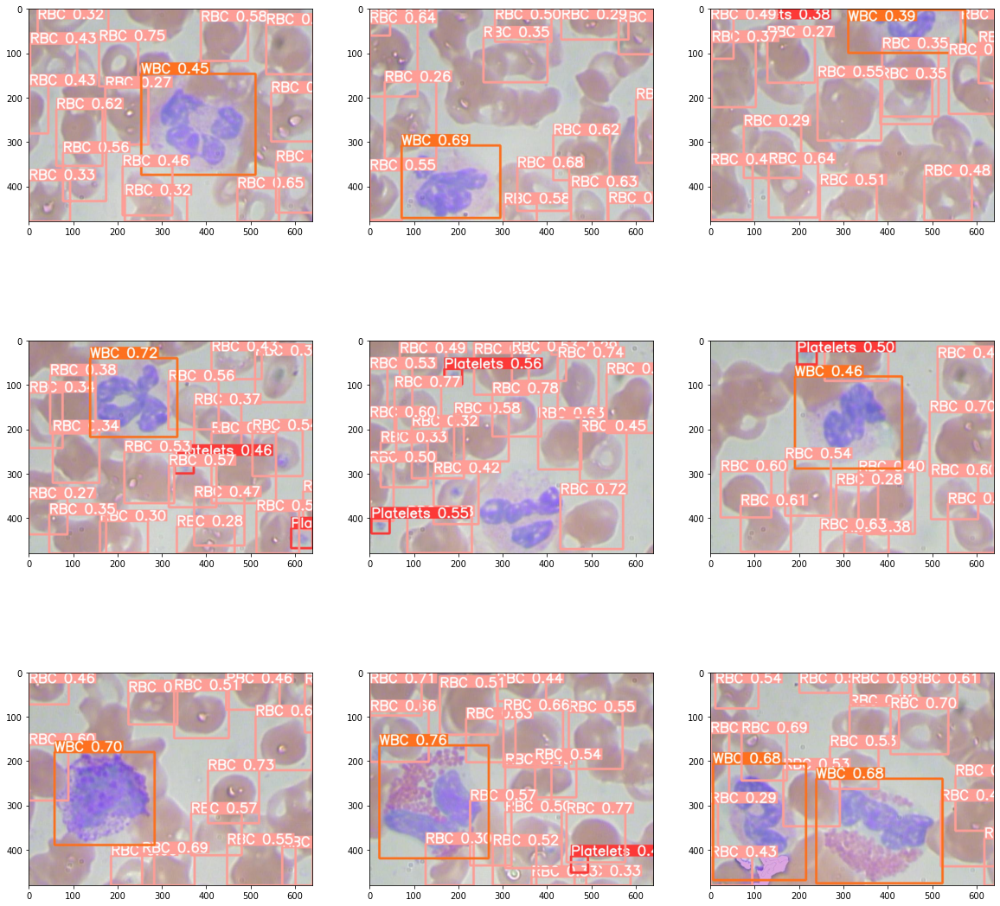

In [22]:
import os
import numpy as np
from PIL import ImageFile, Image
import numpy
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

folder_dir = './yolov5/inference/output/exp'
files = os.listdir(folder_dir)
i=0
fig, axes = plt.subplots(3, 3,figsize=(20,20))
for i, img_name in enumerate(files[:]):
  im = mpimg.imread(folder_dir + '/' + img_name)
  axes[i//3, i%3].imshow(im)
  if i==8:
    break
plt.show()


In [39]:
!ls

 bcc	        bcc.yaml		  'Colab Notebooks'
 BCCD_Dataset   blood_cell_detection.csv   yolov5


# Convey outputs from the .txt file to image :

Also, we can save the output to a .txt file, which contains some of the input image’s bbox co-ordinates. Run the below code, to get the outputs in .txt file,



In [ ]:
!python yolov5/detect.py --source './yolov5/datasets/bcc/images/valid/' --weights './yolov5/runs/train/BCCM/weights/best.pt' --project './yolov5/inference/outputtxt/ --view-img --save-txt

After running the code, we can see the outputs in the below path. File has
class x_center_norm y_center_norm width_norm height_norm


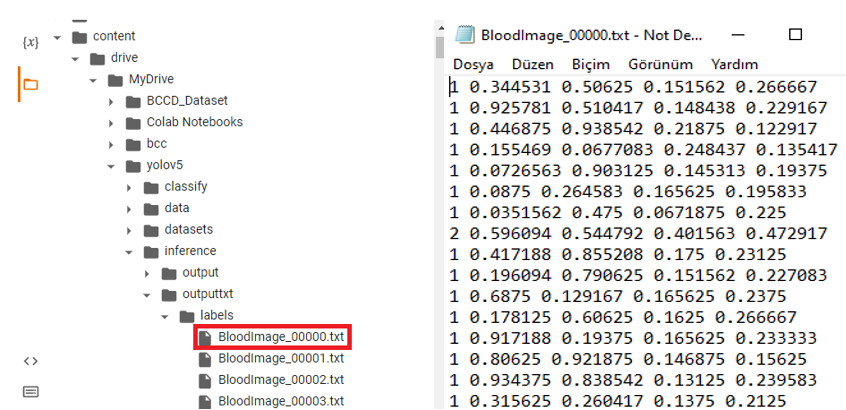



# Code Snippet For Running Model As Production Model
Below code snippet which shows one predicted pictures with all system path and library requirements. My model and programs run accordingly.After running for image, it shows detection result class, bounding box and confidence score. Now model can be given to production. Any questions are welcome regarding training and inference. Thank you.

['/content/drive/My Drive/yolov5', '/content/drive/My Drive/yolov5', '/content/drive/My Drive/yolov5', '/content/drive/My Drive/yolov5', '/content/drive/My Drive/yolov5', '/content/drive/My Drive/yolov5', '/content/drive/My Drive/yolov5', '/content/drive/My Drive/yolov5', '/content/drive/My Drive/yolov5', '/content/drive/My Drive/yolov5', '/content/drive/My Drive/yolov5', '/content', '/env/python', '/usr/lib/python37.zip', '/usr/lib/python3.7', '/usr/lib/python3.7/lib-dynload', '', '/usr/local/lib/python3.7/dist-packages', '/usr/lib/python3/dist-packages', '/usr/local/lib/python3.7/dist-packages/IPython/extensions', '/root/.ipython']
/content/drive/My Drive
detect: weights=['./yolov5/runs/train/BCCM/weights/best.pt'], source=./BCCD_Dataset/BCCD/JPEGImages/BloodImage_00000.jpg, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=cpu, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_n

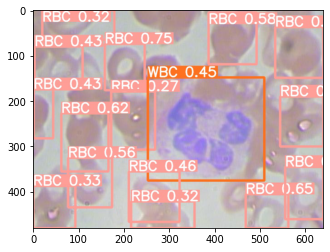

In [53]:
import os, sys, random
from glob import glob
import matplotlib.pyplot as plt
%matplotlib inline
!pip install -qr '/content/drive/My Drive/yolov5/requirements.txt'  # install dependencies

## Add the path where you have stored the neccessary supporting files to run detect.py ##
## Replace this with your path.##
sys.path.insert(0, '/content/drive/My Drive/yolov5') 
print(sys.path)
cwd = os.getcwd()
print(cwd)

## Single Image prediction
## Beware the contents in the output folder will be deleted for every prediction
#source './yolov5/datasets/bcc/images/valid/'
!python yolov5/detect.py --source './BCCD_Dataset/BCCD/JPEGImages/BloodImage_00000.jpg' --weights './yolov5/runs/train/BCCM/weights/best.pt' --project './yolov5/inference/output/production' --device 'cpu'
img = plt.imread('./yolov5/inference/output/production/exp3/BloodImage_00000.jpg')
plt.imshow(img)
